# Rain in Australia

Question: Is it possible to predict that tomorrow will be rainy or not?

Answer: Yes, we have reasonably enough data to predict.

And now we will dive into the given dataset and then show several different models for prediction.

As we said, before to start exploration of models, we need to be sure that dataset is appropirate for this purpose.

Generally yes, however, we still require some "cleaning" and as a first step we are going to fix it.

# Data Cleaning and Expoloration

Installing ydata_profiling package. As we will use this package later for Exploring our Data.

In [1]:
%pip install ydata_profiling

Note: you may need to restart the kernel to use updated packages.


First we import all the Python libraries we are going to use in this section and more. And also using Pandas, we are going to read the data from the CSV file.

In [2]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from ydata_profiling import ProfileReport
from sklearn.preprocessing import LabelEncoder

data = pd.read_csv('weatherAUS.csv')

/Users/denishoti/KU/ML/Project/Rain-in-Australia/.venv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Reading raw data and illustrating information about unique values, distributions, missing variables, their types and so on with **ProfileReporter** (it is very good tool for gaining first insights). This illustration also shows some alerts which our mission is solving them as much as possible. You may want to look at **Alerts** section to compare after finishing **EDA**.

### About ydata-profiling package
[*ydata-profiling*](https://docs.profiling.ydata.ai/latest/) is a package for data profiling, which automates and standardizes the generation of detailed reports, complete with statistics and visualization. As we know the quality of Data Profiling is a key in the process of Data Science and Machine Learning development. The whole importance of this package is the quality of the data analysis and visualisation it gives back with only a single line of code.

ydata-profiling is a great tool to use as with single implementation it supports Exploratory Data Analysis (EDA), provides comprehensive inights, enhances data quality, data exploratory for large datasest and much more. But how does this package work?

1. **Data Collection**: For data collection this package supports both Pandas DataFrames and also Spark Dataframes, in this project we will be using the first on. So it takes the Pandas DataFrame as an input.
2. **Data Analysis**: It performs an analysis for each columns, this analysis includes:
    - **Type Detection**: Determines if columns are numerical, categorical, boolean, or datetime.
    - **Descriptive Statistics**: Calculates metrics like mean, median, mode, standard deviation, min, max, and quantiles for numerical columns.
    - **Missing Values**: Analyzes and reports the amount and distribution of missing data.
    - **Unique Values**: Reports the number of unique values and their frequency.
    - **Correlations**: Calculates and visualizes correlations between numerical columns using Pearson, Spearman, and Kendall methods.
    - **Interactions**: Examines relationships between variables.
    - **Duplicates**: Detects and reports duplicate rows.
3. **Report Generation**: It created a HTML report which will include the overview of dataset, the detailed analysis and all the visualisations (histograms, bar charts, and scatter plots) and also includes warnings about potential issues (high cardinality, skewness). And another very good features is that reports can be also embedded in Jupyter Notebooks.

In the code below, we using the ProfileReporter, we will generate a detailed report. To do that we first check if the report already exists in this folder (if it was generated when the code has run before, so we don't spend time again regenerating it). If no, Profile report will generate it.

In [4]:
report_file = 'weatherAUS_report.html'

if not os.path.exists(report_file):
    profile = ProfileReport(data, title = 'Weather in Australia - Report')

    profile.to_file('weatherAUS_report_1.html')
    profile.dump('report_1')

profile = ProfileReport().load('report_1.pp')
profile.to_notebook_iframe()


Summarize dataset:  83%|████████▎ | 25/30 [00:02<00:00, 10.27it/s, Calculate auto correlation]    /Users/denishoti/KU/ML/Project/Rain-in-Australia/.venv/lib/python3.12/site-packages/ydata_profiling/model/correlations.py:66: UserWarning: There was an attempt to calculate the auto correlation, but this failed.
To hide this warning, disable the calculation
(using `df.profile_report(correlations={"auto": {"calculate": False}})`
If this is problematic for your use case, please report this as an issue:
https://github.com/ydataai/ydata-profiling/issues
(include the error message: 'could not convert string to float: 'Albury'')
  warnings.warn(
Render HTML: 100%|██████████| 1/1 [00:06<00:00,  6.75s/it]


Based on the Profile Report given by the package ydata-profiling, we can answer some questions related to the dataset.
- Our dataset contains of 23 features (variables), 1 feature is a DateTime feature ("Date"), we have 4 Categorical Features ("Location", "WindGustDir", "WindDir9am" and "WindDir3pm"), there are 16 Numeric Features - Real Number ("MinTemp", "MaxTemp", "Rainfall", "Evaporation", "Sunshine", "WindGustSpeed", "WindSpeed9am", "WindSpeed3pm", "Humidity9am", "Humidity3pm", "Pressure9am", "Pressure3pm", "Cloud9am", "Cloud3pm", "Temp9am" and "Temp3pm"), and lastly we have only 2 Boolean Features ("RainToday" and "RainTomorrow").

- Now we are going to go into details to the features, and for each of them explain their meaning, if they have missing values or their correlations:
    - **Date**: This includes data from the almost 10 years about the weather in Australia, the Date Starts on the 1st of November 2007 up to 25th of June 2017.
    - **Location**: As said before it is a Categorical data, it shows we have data for 49 cities of Australia
    - **MinTemp**: Shows the Minimum temperature recorded at that exact time. This feature has missing values (around 1% which means 1485 missing values) and also has High Correlation, in the Report you can see detailed values of Mean,  Minimum, Maximum etc..
    - **MaxTemp**: Shows the Maximum temperature recorded at that exact time. This feature has a High Correlation, it has 1261 missing values which is around 0.9%.
    - **Rainfall**: This represents the quantity of water (represented in millimeters or inches), that is percipitated in liquid in a specified area and time interval. There is a high number of missing data around 2.2% (3261), there is a High Correlation. it says it contains zero values but for this case, this is not an error because there are of course days when it doesn't rain at all.
    - **Evaporation**: It's the process that changes a substance from a liquis into a gas or vapor (it can be easily visualized when rain puddles "disappear" on a hot day). The evaporation is measured using the Eddy covariance instrument, it is measured by means of evaporimeters. [Article about how the evaporation is measured](https://link.springer.com/chapter/10.1007/978-3-319-69185-5_10#:~:text=Evaporation%20is%20measured%20by%20means,is%20measured%20at%20regular%20intervals.). There is a high number of missing values around 43.2% and there is a high correlation.
    - **Sunshine**: the duration of direct solar radiation over a certain period of time, it has 48% of missing data, it contains 0 values which is also normal for this feature.
    - **WindGustDir**: show in which directions a sudden brief increase in speed of the wind happened. There are 7.1% of missing data.
    - **WindGustSpeed**: shows the speed of the sudden brief increase in speed of the wind. It has also 7.1% missing data and high correlation.
    - **WindDir9am** and **WindDir3pm**: show the direction of speed in two different times of the at 9am and 3pm. Both of these features have missing data.
    - **WindSpeed9am** and **WindSpeed3pm**: They show the speed of wind in two different times. These have a high correlation with WindGustSpeed
    - **Humidity9am** and **Humidity3pm**: They show the amount of water vapor in the air. There are missing Datas. It has a High Correlation (Check the Heatmap Correlation Graph), it has negative correlation with Temperature and Evaporation
    - **Pressure9am** and **Pressure3pm**: Show the Air Pressurenat the two different time splots. It has missing values and also High correlation.
    - **Cloud9am** and **Cloud3pm**: It the values of clouds. It has High Correlation, missing values 38.4%, also contains zeros which is not a problem for us.
    - **Temp9am** and **Temp3pm**: It shows the temperature measured at 9am and at 3 am. It includes around 2.5% missing values, and also has a high correlation.
    - **RainToday** and **RainTomorrow**: Both boolean features, they contain 2.2% of missing values, they have a high correlation with each other.

This was a short introduction to the features, to have a deeper look on them read the report from the ydata-profiling.

- Lets have another look about the relations between the features:
    - Temperature Extremes and Rainfall: Analyzing whether days with extreme temperatures (either high or low) are more likely to have rainfall could be insightful.
    - WindGustSpeed and Rain: Very high wind gusts might correlate with heavy rain events.
    - Pressure and RainTomorrow: Sudden drops in pressure could be predictive of rain the following day.

As we can see from the report above, there are also outliers in our dataset and we are going to illustrate them in details below.

### Outliers

First thing, we have to understand, what is an outlier?

In statistics, an outlier us a data point that differs significantly from other observations. For example we can take a group of 5 students, their exam grades are 9, 8, 9, 7, and 2. The last value seems to be an outlier because it falls below the main patter of other grades.

Based on the upper data report, we could see this, now we want to generate some specific graphs (box plots) for each of our numeric values, which will show to us in details for each variable the outluers.
Box plots are used to show the distribution of numeric data values.

We use the library seaborn for the generation of the box plots.

In [9]:
numeric_cols = data.select_dtypes(include = ['float64']).columns

plt.figure(figsize=(25, 15))  

for column in range(len(numeric_cols)):
    plt.subplot(4, 4, column + 1)
    sns.boxplot(y = data[numeric_cols[column]])  
    plt.title(f'The boxplot of {numeric_cols[column]}')  
    
plt.tight_layout()  
plt.show()

/var/folders/8l/6nrs6y7n4mq4knsh7f4x8v0c0000gn/T/ipykernel_65849/2398251737.py:11: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  plt.show()


After Reviewing the outliers. Now we are to the step to replace these outliers in our dataset.

There are a lot of methods for this replacement, you can use different inputation techniques here, like use median or mean or other inputation. We decided for this step to replace all the outliers with NaN values. In this way, when later in our code, we do the inputation of mixing data using a very fancy method (lightgbm), we will also input for these outliers as well.

For each of the numeric columns: 
- We calculate the first quartile (25%) and the 3rd quartile (75%)
- Using the first and the third quartile, we can calculate the IQR (The Interquartile range). It measures the spread of the middle 50% of the data.
- Then using all of these three values (Q1, Q2 and IQR) we calculate the upper bound and lower bound, for detecting the outliers
- Then if any of the data in that column is an bigger or equal to the upper bound or less or equal to the lower bound, it is replaced with NaN value

In [10]:
for column in numeric_cols:

    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    mean = data[column].median()

    IQR = Q3 - Q1

    upper = Q3 + IQR * 1.5
    lower = Q1 - IQR * 1.5

    data.loc[data[column] >= upper, column] = np.nan
    data.loc[data[column] <= lower, column] = np.nan

Now that we did the replacement of the outlier with NaN values, we again create box plots for all the numeric columns, to check the results.

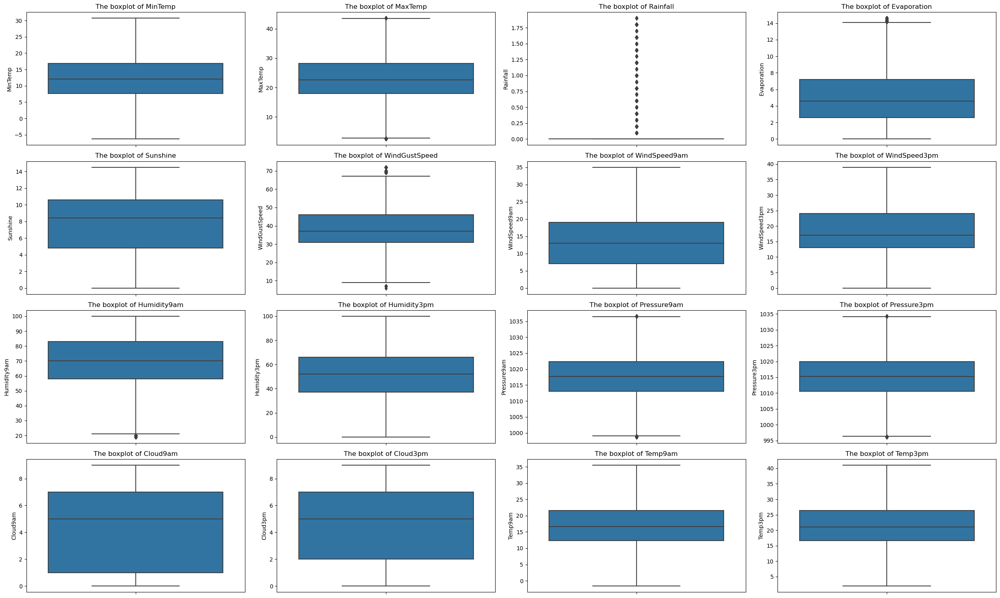

In [93]:
plt.figure(figsize=(25, 15))  

for column in range(len(numeric_cols)):
    plt.subplot(4, 4, column + 1)
    sns.boxplot(y = data[numeric_cols[column]])  
    plt.title(f'The boxplot of {numeric_cols[column]}')  
    
plt.tight_layout()
plt.show()

We have handled most of the outliers but still there are some and we do not continue further because manipulating them too much can affect results in a bad way.

### Data Encoding

Encoding date and boolean values into numeric values.

Encoding date as month and days (Year is ignored because it has not much impact on forecasting - years are roughly same - mostly month and the day of the month impacts.)

We discussed and thought this deeply, taking into consideration different approeaches and decided this would be the best approach for us. For the reasons below:
  - Simplier: encoding dates in this way simplifies the data and reduces the complexity that comes with handling full date information.
  - Seasonability: This approach might help the model to capture seasonal patterns, which are crucial in the weather prediction.

There were also some cons that we had in mind:
  - Loss of information: by ignoring the year, we lose the ability to capture trends over the years (long term climate change effects).
  

We tried both of these methods, keeping the year, or only using the months and days, and we did get the same results. So, for our dataset it would be possible to use this encoding method.

As for the code, we use methods of pandas, such as (sort_values, drop and insert), which as by their name are self exploratory what they do.

Then, for "RainToday" and "RainTomorrow" we encode them as Binary Categorical Data (0 or 1, True and False). We map every value 'Yes' to 1 and every value 'No' to 0. This step is very important, as this makes it very easy to use in our machine learning algorithms, which typically requires numeric inputs.

- [.map()](https://www.geeksforgeeks.org/python-map-function/) function returns a map object(which is an iterator) of the results after applying the given function to each item of a given iterable (list, tuple etc.)
- [.astype()](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.astype.html) is a pandas method that casts a pandas object to a specified data type



We decided to deop all the columns in which our target values are missing. First of all we checked how many of that would be. And we could see that it was only 4573 instances (3.15%) of our dataset, its not a high percentage. As we thought with this approach, we dont interfere with inputing data for the target value. And this could at least not impact our dataset for worse.
- **.dropna**: is a method in pandas to remove missing values (NaN) from a DataFrame.
  - as a first parameter this method gets where it should consider to look for missing data. In our case we consider the last column of our DataFrame, so the last column in our case is our target value (RainTomorrow).
  - then ´inplace = True´, it tells that this change should take place in the current DataFrame, if you change it to False, it leaves the main DataFrame untouchable, and created a new DataFrame without the NaN Values.

In [11]:
data.sort_values(by = 'Date', inplace = True, ascending = True, ignore_index = True)

dates = pd.to_datetime(data['Date'])

data.drop('Date', axis = 1, inplace = True)
data.dropna(subset = 'RainTomorrow', inplace = True)

data.insert(0, 'Day', dates.dt.day.astype('float64'))
data.insert(0, 'Year', dates.dt.year.astype('float64'))
data.insert(0, 'Month', dates.dt.month.astype('float64'))

data['RainToday'] = data['RainToday'].map({'Yes': 1, 'No': 0}).astype('float64')
data['RainTomorrow'] = data['RainTomorrow'].map({'Yes': 1, 'No': 0}).astype('float64')

data.head()

,Month,Year,Day,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,11.0,2007.0,1.0,Canberra,8.0,24.3,0.0,3.4,6.3,NW,...,68.0,29.0,1019.7,1015.0,7.0,7.0,14.4,23.6,0.0,1.0
1,11.0,2007.0,2.0,Canberra,14.0,26.9,NaN,4.4,9.7,ENE,...,80.0,36.0,1012.4,1008.4,5.0,3.0,17.5,25.7,1.0,1.0
2,11.0,2007.0,3.0,Canberra,13.7,23.4,NaN,5.8,3.3,NW,...,82.0,69.0,1009.5,1007.2,8.0,7.0,15.4,20.2,1.0,1.0
3,11.0,2007.0,4.0,Canberra,13.3,15.5,NaN,7.2,9.1,NW,...,62.0,56.0,1005.5,1007.0,2.0,7.0,13.5,14.1,1.0,1.0
4,11.0,2007.0,5.0,Canberra,7.6,16.1,NaN,5.6,10.6,SSE,...,68.0,49.0,1018.3,1018.5,7.0,7.0,11.1,15.4,1.0,0.0


In this part we first split the original dataset "data" into two subsets, a training set and a testing set.

Then we continue further splitting, we split the training set into:

- The training set is used to train the machine learning model, it is 65% from the index 0 to 65% of the total length.
- The testing set is used to evaluate the model's performance on unseen data
- The validation set is used to fine-tune the model's hyperparameters and prevent overfitting, it is 15% of the total data, from 65% to the 80% of the total length.

This splitting ensures that each subset is mutually exclusive and collectively exhaustive, covering the entire dataset.

This preprocessing step is essential for training and evaluating machine learning models effectively, it is 20%, from 80% to the end of DataFrame.

In [12]:
leng = data.__len__()

data_train_set = data.iloc[: np.ceil(leng * 0.65).astype(int)].copy()
data_val_set = data.iloc[np.ceil(leng * 0.65).astype(int) : np.ceil(leng * 0.8).astype(int)].copy()
data_test_set = data.iloc[np.ceil(leng * 0.8).astype(int) :].copy()

Encoding categorical features via LabelEncoder which basically express them with numbers.

We will use LabelEncoder from the scikit-learn library, which is a good practice for preparing the data for a machine learning model that requires numerical inputs. It handles the categorical data efficiently.

In [13]:
le = LabelEncoder()

for feature in data_train_set.select_dtypes('object').columns.to_list():
    data_train_set.loc[:, feature] = le.fit_transform(data_train_set[feature].astype(str))
    data_test_set.loc[:, feature] = le.transform(data_test_set[feature].astype(str))
    data_val_set.loc[:, feature] = le.transform(data_val_set[feature].astype(str))

data_train_set.head()

,Month,Year,Day,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,11.0,2007.0,1.0,9,8.0,24.3,0.0,3.4,6.3,7,...,68.0,29.0,1019.7,1015.0,7.0,7.0,14.4,23.6,0.0,1.0
1,11.0,2007.0,2.0,9,14.0,26.9,NaN,4.4,9.7,1,...,80.0,36.0,1012.4,1008.4,5.0,3.0,17.5,25.7,1.0,1.0
2,11.0,2007.0,3.0,9,13.7,23.4,NaN,5.8,3.3,7,...,82.0,69.0,1009.5,1007.2,8.0,7.0,15.4,20.2,1.0,1.0
3,11.0,2007.0,4.0,9,13.3,15.5,NaN,7.2,9.1,7,...,62.0,56.0,1005.5,1007.0,2.0,7.0,13.5,14.1,1.0,1.0
4,11.0,2007.0,5.0,9,7.6,16.1,NaN,5.6,10.6,10,...,68.0,49.0,1018.3,1018.5,7.0,7.0,11.1,15.4,1.0,0.0


We wanted to use the Correlation Matrix, where each cell in the table shows the correlation between two variables. This Correlation Matrix will help us to identify the relationships between variables, for freature selection and multicollinearity.

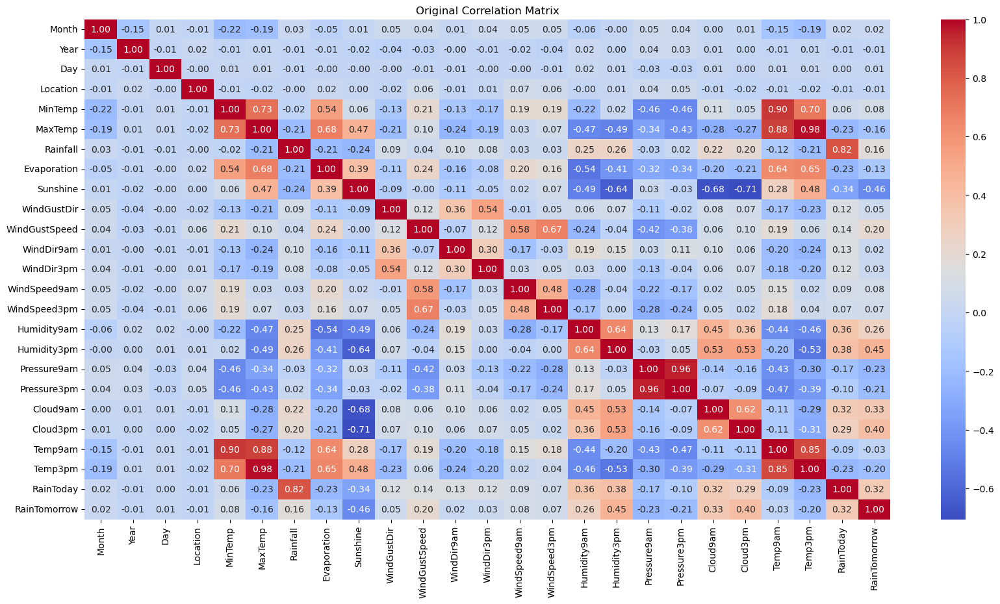

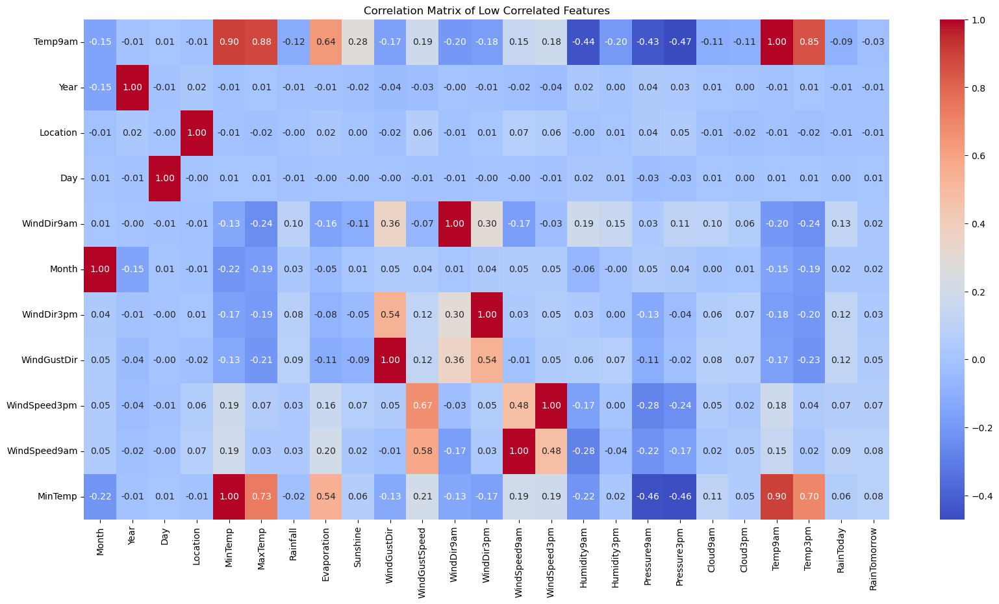

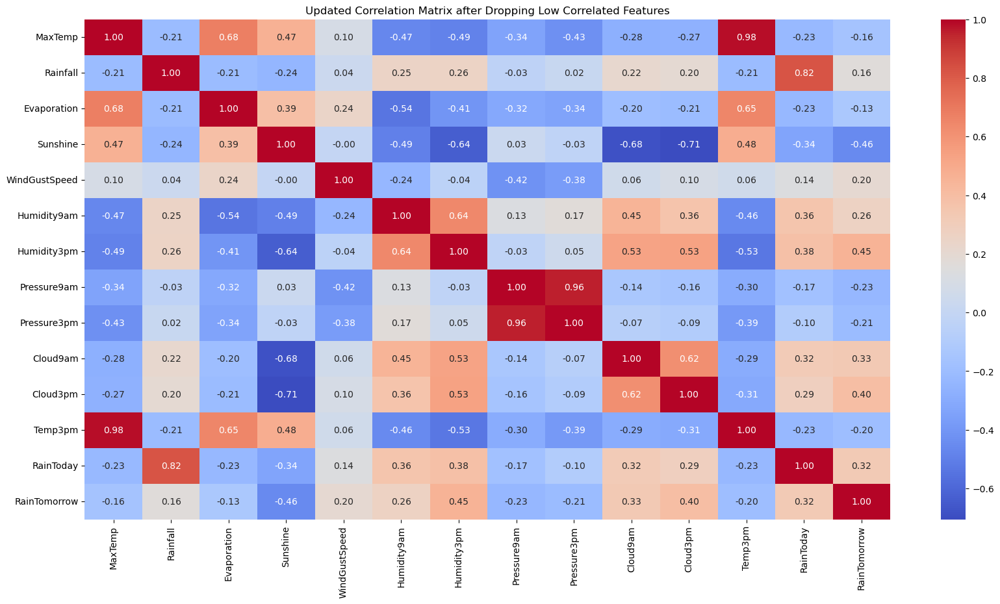

In [97]:
correlation_matrix = data_train_set.corr()

plt.figure(figsize = (20, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Original Correlation Matrix')
plt.show()

correlation_with_target = correlation_matrix['RainTomorrow'].sort_values(ascending = True)

# Identify features with low correlation to the target (absolute correlation < 0.1)
low_correlation_features = correlation_with_target[correlation_with_target.abs() < 0.1].index.tolist()

plt.figure(figsize = (20, 10))
sns.heatmap(correlation_matrix.loc[low_correlation_features], annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix of Low Correlated Features')
plt.show()

# Drop low correlated features from the dataset
data_train_set.drop(columns = low_correlation_features, inplace = True)
data_test_set.drop(columns = low_correlation_features, inplace = True)
data_val_set.drop(columns = low_correlation_features, inplace = True)

correlation_matrix_dropped = data_train_set.corr()

plt.figure(figsize = (20, 10))
sns.heatmap(correlation_matrix_dropped, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Updated Correlation Matrix after Dropping Low Correlated Features')
plt.show()

This correlation Matrix provides insights into the relationships between different features in our dataset.

We can see that, "RainToday", "Humidity3pm" and "Cloud3pm" have a strong correlation with "RainTomorrow".

It is also very noticeable that the "MaxTemp" and the "MinTemp" are strongly positively correlated, as well as "Temp9am" with "Temp3pm", and "Humidity9am" with "Humidity3pm".
Also, "MaxTemp" and "Temp3pm" are almost perfectly correlated, which makes sense as 3 PM is often the hottest part of the day.

As a result, we drop 11 low-correlated features (almost half of the features) and continue with 13 features which will help our models to train faster without loss of important information (in some cases even better results). One can ask why features like 'MinTemp' and 'WindSpeed3pm' have dropped. Because we select features whose correlation is lower than 0.1 and they have a 0.1 correlation, it is true mathematically they shouldn't be dropped. However, it seems we use the 'fmt' parameter in the illustration of matrices which is the precision of values in the matrix. If we increase that value it will be seen correlations of those features are lower than 0.1 and because of rounding, they look like 0.1 but in reality, they are not.

# Inputation of Missing Values

Here we illustrate missing values with percentage.

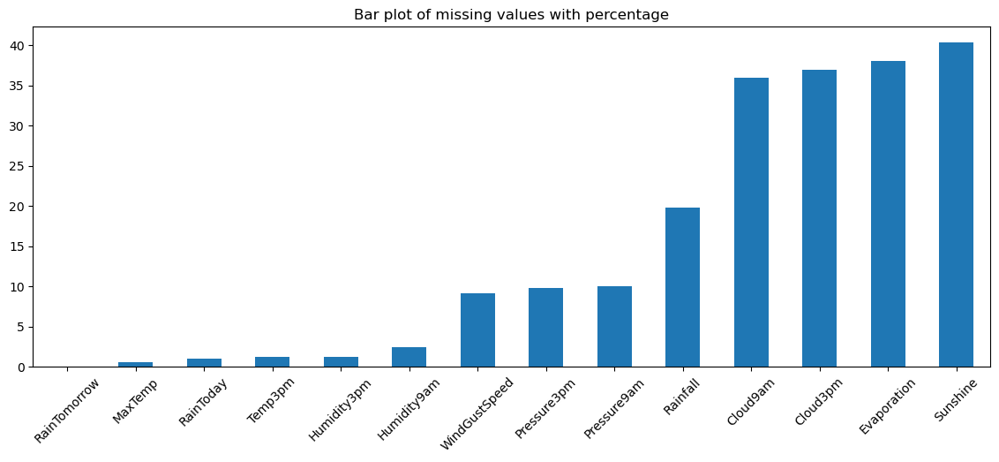

In [98]:
plt.figure(figsize=(14,5))
missing = data_train_set.isnull().sum() / data_train_set.shape[0] *100
missing = missing.sort_values().plot.bar()

plt.xticks(rotation = 45)
plt.title('Bar plot of missing values with percentage')
plt.show()

Then installing the lightgbm package which we will use to input missing values.

In [14]:
%pip install lightgbm

Note: you may need to restart the kernel to use updated packages.


In [100]:
import lightgbm as lgb

We wanted to use some advanced (fancy😊) way to input data. Here we use one of the gradient models to train on train set and then we apply those submodels to each data set.

Using machine learning models for inouting missing data is a very effective method, as it utilizes the relationships within the dataset to predict and fill in missing values, ensuring that the imputed values are as accurate as possible given the available data.

We have a function determine_objective() which determines the type of machine learning task (regression, binary classification, or multiclass classification) based on the feature's characteristics.
Then the function Training_Inputation_Models() trains imputation models for each feature with missing values and stores them.
And Inputation_Of_Missing_Values() uses the trained imputation models to fill in missing values in new datasets.

This approach can lead to more accurate and reliable imputations compared to simpler methods like mean, median, or mode imputation.

Please be aware if this code returns an error, in the params change the 'device_type' to your device type for example cpu.

In [101]:
def determine_objective(feature):
    if feature.dtype.kind == 'f':
        return 'regression'
    elif len(feature.value_counts()) == 2:
        return 'binary'
    else:
        return 'multiclass'

inputation_models = {}

categorical_features =  data_train_set.select_dtypes(include = ['object']).columns.tolist()

def Training_Inputation_Models(dataset):
    columns = dataset.columns.tolist()
    columns.remove('RainTomorrow')

    for target in columns:
        
        indices = dataset.index[dataset[target].isna()]

        if indices.empty:
            continue

        """
        Dropping columns which target contains NaN values and saving corresponding features in X_target.
        It will be used for predicting dropped NaN values.
        """
        if not indices.empty:
            X_target = dataset.loc[indices].drop(target, axis = 1)

        dropped_data = dataset.dropna(subset = target)

        X_train, Y_train = dropped_data.drop(target, axis = 1), dropped_data[target]

        """
        Parameters of LightGBM model
        """
        objective = determine_objective(dataset[target])

        params = {
            'objective': objective,                  # using regression, binary or multiclass model
            'boosting': 'gbdt',                      # model uses Gradient Boosting which aimed to minimize loss (error)
            'learning_rate': 0.1,                    # the step which model makes in each iteration for minimizing loss
            'num_leaves': 100,                       # number of leaves for tree model
            'verbose': -1,                           # force model not to show additional text information
            'device_type': 'gpu'                     # it says to algorithm to use gpu
        }

        if objective == 'multiclass':
            params['num_class'] = len(dataset[target].unique())

        """
        As there is no test case, we train our model with full dataset (after dropping NaN target values).
        """
        train_set = lgb.Dataset(X_train, label = Y_train)

        model = lgb.train(params, train_set, num_boost_round = 100)
        if not indices.empty:
            Y_target = model.predict(X_target, num_iteration = model.best_iteration)
            
            """
            Writing predicted targets back to the data which also helps to have richer dataset in each iteration.
            """
            dataset.loc[indices, target] = Y_target
        
        inputation_models[target] = model

def Inputation_Of_Missing_Values(dataset):

    nan_contained_cols = dataset.columns[dataset.isna().any()].tolist()

    for target in nan_contained_cols:
        indices = dataset.index[dataset[target].isna()]

        X_target = dataset.loc[indices].drop(target, axis = 1)
        Y_target = inputation_models[target].predict(X_target)

        dataset.loc[indices, target] = Y_target


Training_Inputation_Models(data_train_set)
Inputation_Of_Missing_Values(data_val_set)
Inputation_Of_Missing_Values(data_test_set)

# Evaluation of Models

Here we are going to see different results of different models in order to find the best one.

We will use the KNN Classification Model, Logistic Regression, Random Fores, XGBoost Model, and Neural Network Model.

Importing xgboost package and splitting the data using TimeSeriesSplit as our dataset includes of data that has timeseries.

In [15]:
%pip install xgboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 9.3 MB/s eta 0:00:00:00:0100:01
Note: you may need to restart the kernel to use updated packages.


In [103]:
import numpy as np
import matplotlib.pyplot as plt
from xgboost import XGBClassifier
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit, RandomizedSearchCV
from sklearn.metrics import f1_score, recall_score, precision_score, precision_recall_curve

X_train, Y_train  = data_train_set.drop('RainTomorrow', axis = 1), data_train_set['RainTomorrow']
X_test, Y_test  = data_test_set.drop('RainTomorrow', axis = 1), data_test_set['RainTomorrow']
X_val, Y_val  = data_val_set.drop('RainTomorrow', axis = 1), data_val_set['RainTomorrow']

tscv = TimeSeriesSplit(n_splits = 5)

Some functionalities used oftenly, so this part contains those kinds of functions in order to decrease repetitions.
- Threshold_Optimizer: This function finds the optimal threshold for a binary classification model based on the F1 score and evaluates the model on the test set using this threshold.
- Results_Before_Threshold_Optimization: This function evaluates the model's performance on the training and test sets using the default threshold (0.5).

In [104]:
def Threshold_Optimizer(model, x_test, y_test):
    y_val_prob = model.predict_proba(X_val)[:, 1]

    precisions, recalls, thresholds = precision_recall_curve(Y_val, y_val_prob)
    f1_scores = 2 * (precisions * recalls) / (precisions + recalls)
    optimal_index = np.argmax(f1_scores)
    optimal_threshold = thresholds[optimal_index]

    """
    Precision-Recall curve illustrates the optimal threshold value which maximizes both recall and precision (as a result f1 score). As long as we do not have special requirement such as bounded recall or precision. We keep this threshold value.
    """

    plt.figure()
    plt.plot(recalls, precisions, color='b',  label='PR curve')
    plt.scatter(recalls[optimal_index], precisions[optimal_index], marker='o', color='black', label='Optimal threshold')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall curve')
    plt.legend(loc="lower left")
    plt.show()

    y_test_prob = model.predict_proba(x_test)[:, 1]

    y_test_pred = (y_test_prob >= optimal_threshold).astype(int)

    print('F1 Test: ', f1_score(y_test, y_test_pred))
    print('Recall Test: ', recall_score(y_test, y_test_pred))
    print('Precision Test: ', precision_score(y_test, y_test_pred))

def Results_Before_Threshold_Optimization(model, x_test, y_test):
    pred_train_set = model.predict(X_train)
    pred_test_set = model.predict(x_test)

    print('Recall Train: ', recall_score(Y_train, pred_train_set))
    print('Recall Test: ', recall_score(y_test, pred_test_set))
    print('Precision Train: ', precision_score(Y_train, pred_train_set))
    print('Precision Test: ', precision_score(y_test, pred_test_set))
    print('F1 Train: ', f1_score(Y_train, pred_train_set))
    print('F1 Test: ', f1_score(y_test, pred_test_set))

### KNN Classification

K-Nearest Neighbors (KNN) is a simple, instance-based learning algorithm that can be effective for datasets with fewer features. It's useful for identifying patterns based on proximity, but it can take a lot of time with large datasets.


Recall Train:  0.6377975200722125
Recall Test:  0.5542168674698795
Precision Train:  0.7912418223610538
Precision Test:  0.7403874813710879
F1 Train:  0.7062815656565656
F1 Test:  0.6339160393007528


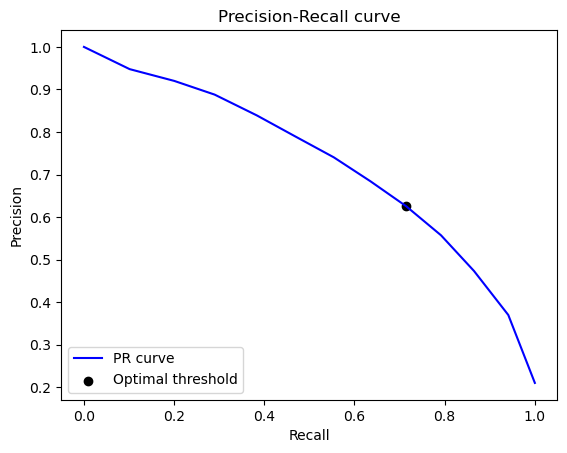

F1 Test:  0.6670832031656774
Recall Test:  0.714636323070058
Precision Test:  0.6254637766061316


In [105]:
pipeline = make_pipeline(
    StandardScaler(),
    KNeighborsClassifier(n_neighbors = 11)
)

grid_search_cv = GridSearchCV(
    pipeline,
    param_grid = {},
    cv = tscv,
    scoring = 'f1',
    n_jobs = -1
)

grid_search_cv.fit(X_train, Y_train)

knn_model = grid_search_cv.best_estimator_

Results_Before_Threshold_Optimization(knn_model, X_val, Y_val)

Threshold_Optimizer(knn_model, X_val, Y_val)

### Logistic Regression

Logistic Regression is a widely-used, interpretable model for binary classification problems. It provides probabilities and can handle linear relationships between features and the target variable.

Recall Train:  0.8040286949498788
Recall Test:  0.7634984381972334
Precision Train:  0.5489636381329268
Precision Test:  0.5480461242793081
F1 Train:  0.6524538339951425
F1 Test:  0.6380757038970726


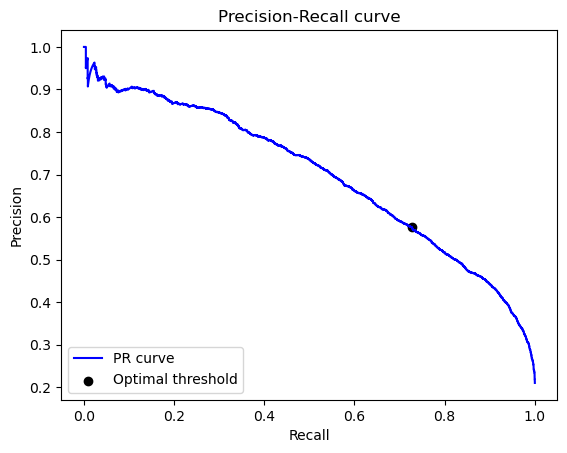

F1 Test:  0.6431109356494276
Recall Test:  0.7269076305220884
Precision Test:  0.5766371681415929


In [121]:
"""
Here we use all possible combinations, while some pentalties do not support all solvers, we should define permutations of parameters such that

params_log = [
    {'log_reg__penalty': ['l1'], 'log_reg__C': [10 ** i for i in range(-3, 4)], 'log_reg__class_weight': ['balanced', None], 'log_reg__solver': ['liblinear', 'saga']},
    {'log_reg__penalty': ['l2'], 'log_reg__C': [10 ** i for i in range(-3, 4)], 'log_reg__class_weight': ['balanced', None], 'log_reg__solver': ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']},
    {'log_reg__penalty': ['elasticnet'], 'log_reg__C': [10 ** i for i in range(-3, 4)], 'log_reg__class_weight': ['balanced', None], 'log_reg__solver': ['saga']},
    {'log_reg__penalty': [None], 'log_reg__C': [10 ** i for i in range(-3, 4)], 'log_reg__class_weight': ['balanced', None], 'log_reg__solver': ['lbfgs', 'newton-cg', 'newton-cholesky', 'sag', 'saga']}
]

"""

optimal_params = {
    'C': 2,
    'class_weight': 'balanced',
    'penalty': 'l2',
    'solver': 'newton-cholesky'
}

pipeline = make_pipeline(
    StandardScaler(),
    LogisticRegression(**optimal_params)
)

grid_search_cv = GridSearchCV(
    pipeline,
    param_grid = {},
    cv = tscv,
    n_jobs = -1,
    scoring='f1'
)

grid_search_cv.fit(X_train, Y_train)

log_model = grid_search_cv.best_estimator_

Results_Before_Threshold_Optimization(log_model, X_val, Y_val)

Threshold_Optimizer(log_model, X_val, Y_val)

### Random Forest

**Random Forest** uses multiple trees with wide set of hyperparameters. In our problem that is the most powerful model.

Recall Train:  0.9038434129887406
Recall Test:  0.7469879518072289
Precision Train:  0.7212176352401531
Precision Test:  0.6546734454438795
F1 Train:  0.8022687020325546
F1 Test:  0.6977907461442268


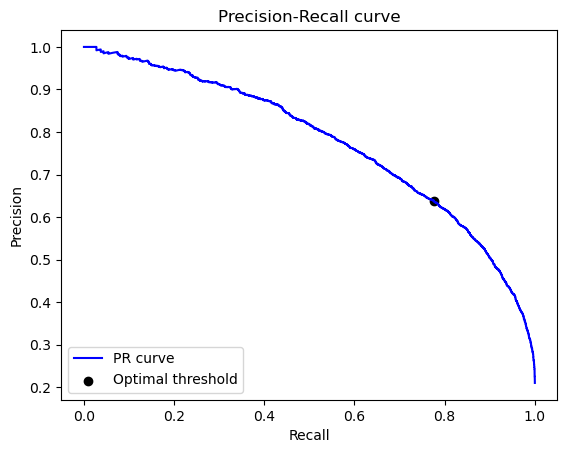

F1 Test:  0.7007755060932621
Recall Test:  0.7762159750111557
Precision Test:  0.6387002019460253


In [107]:
random_params = {
    'n_estimators': 150,
    'max_features': 'sqrt',
    'max_depth': 13,
    'min_samples_split': 2,
    'min_samples_leaf': 4,
    'bootstrap': True,
    'class_weight': 'balanced'
}

grid_search_cv = GridSearchCV(
    RandomForestClassifier(**random_params),
    param_grid = {},
    cv = tscv,
    n_jobs = -1,
    scoring = 'f1'
)

grid_search_cv.fit(X_train, Y_train)

rf_model = grid_search_cv.best_estimator_

Results_Before_Threshold_Optimization(rf_model, X_val, Y_val)

Threshold_Optimizer(rf_model, X_val, Y_val)

### XGBoost

Here again we use a bit fancy **Extreme Gradient Boosting** method which is a bit complicated because of wide range of hyperparameters. We have tried to use most important ones (which are hyperparameters that we understand meanings😅). Aside of complexity and count of hyperparameters that model generates best results in our example and mostly it is one the most powerful tool for many problems. While **XGBoost** is powerful there is trade off in computational power and time for better results. We can say that is also the most time consumed model which requires to underly that it took over **2300 minutes**, in other words more than **38 hours**. There are just a couple of ways to decrease that time and power consumption a bit, however, in any case, if you want to use this model just be prepared.

Recall Train:  0.8878806594137488
Recall Test:  0.7581436858545292
Precision Train:  0.7448487505480053
Precision Test:  0.6923390383048085
F1 Train:  0.8100996965756394
F1 Test:  0.7237486687965922


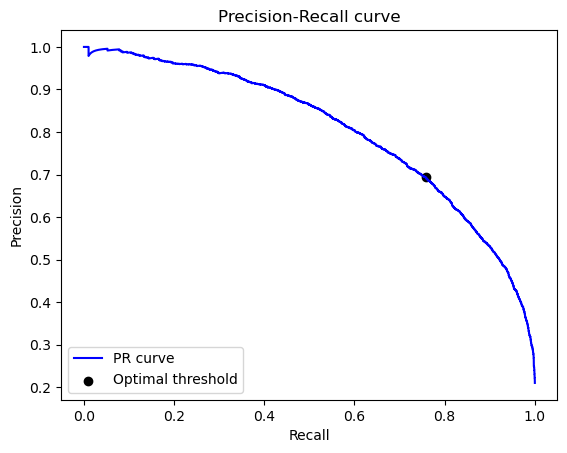

F1 Test:  0.7242298262445368
Recall Test:  0.7579205711735832
Precision Test:  0.6934068177179016


In [108]:
xgb_params = {
    'max_depth': 8,
    'n_estimators': 200,
    'learning_rate': 0.072,
    'scale_pos_weight': 2.5,
}

grid_search_cv = GridSearchCV(
    XGBClassifier(**xgb_params),
    param_grid = {},
    cv = tscv,
    n_jobs = -1,
    scoring = 'f1'
)

grid_search_cv.fit(X_train, Y_train)

xgb_model = grid_search_cv.best_estimator_

Results_Before_Threshold_Optimization(xgb_model, X_val, Y_val)

Threshold_Optimizer(xgb_model, X_val, Y_val)

### Neural Network Model

Neural Networks are flexible models capable of learning complex patterns in the data. They are particularly powerful for large datasets with many features and can capture intricate, non-linear relationships.

Recall Train:  0.5853009644163618
Recall Test:  0.5448460508701473
Precision Train:  0.7816762895755346
Precision Test:  0.7897800776196636
F1 Train:  0.6693833197500679
F1 Test:  0.6448376023237391


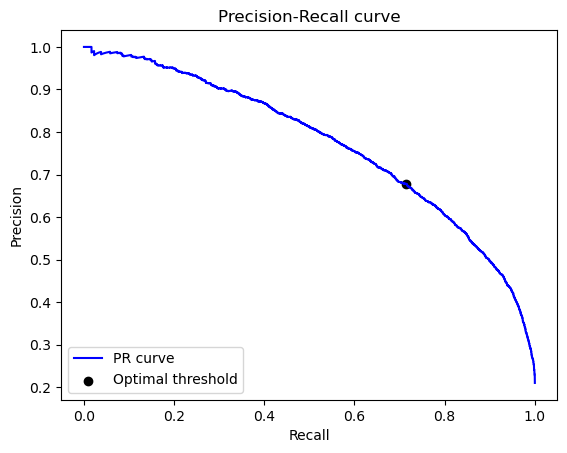

F1 Test:  0.6961241993268917
Recall Test:  0.715305667112896
Precision Test:  0.67794459716642


In [109]:
nn_params = {
    'hidden_layer_sizes': (50, 30),
    'activation':  'tanh',
    'solver': 'sgd',
    'learning_rate': 'adaptive',
    'learning_rate_init': 0.001,
    'alpha': 0.01,
    'momentum': 0.99,
    'early_stopping': True,
    'max_iter': 500
}

pipeline = make_pipeline(
    StandardScaler(),
    MLPClassifier(**nn_params)
)

random_search_cv = GridSearchCV(
    pipeline,
    param_grid = {},
    scoring = 'f1',
    cv = tscv,
    n_jobs = -1
)

random_search_cv.fit(X_train, Y_train)

nn_model = random_search_cv.best_estimator_

Results_Before_Threshold_Optimization(nn_model, X_val, Y_val)

Threshold_Optimizer(nn_model, X_val, Y_val)

### Ensemble Method

This method is designed to evalulate result with votes of given models which helps to increase general results. As it seems while we have KNN and LogisticRegression models, we do not use them because they produce relatively worse results and it impacts final results of VotingClassifier in a decreasing way. Therefore, just **XGBoost**, **RandomForest** and **MLPCLassifier** models are used.

Recall Train:  0.8133403012019573
Recall Test:  0.7059348505131637
Precision Train:  0.7628553604848053
Precision Test:  0.7225393925553779
F1 Train:  0.7872893242280012
F1 Test:  0.7141406161832751


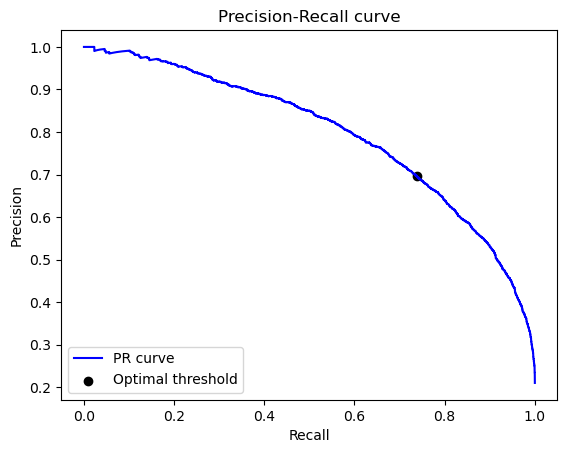

F1 Test:  0.7171815718157182
Recall Test:  0.7380633645693887
Precision Test:  0.6974488720219271


In [123]:
def Voting_Classifier_Model(x_test, y_test):
    voting_classifier = VotingClassifier(estimators = [
        ('rf', rf_model),
        ('nn', nn_model),
        ('xgb', xgb_model),
    ],  voting = 'soft'
    )

    voting_classifier.fit(X_train, Y_train)

    Results_Before_Threshold_Optimization(voting_classifier, x_test, y_test)

    Threshold_Optimizer(voting_classifier, x_test, y_test)

Voting_Classifier_Model(X_val, Y_val)

As a result, we check test case.

### Final Test

Recall Train:  0.814100432324576
Recall Test:  0.7535455404979514
Precision Train:  0.760923623445826
Precision Test:  0.7189896256202075
F1 Train:  0.7866143358810164
F1 Test:  0.7358621220281604


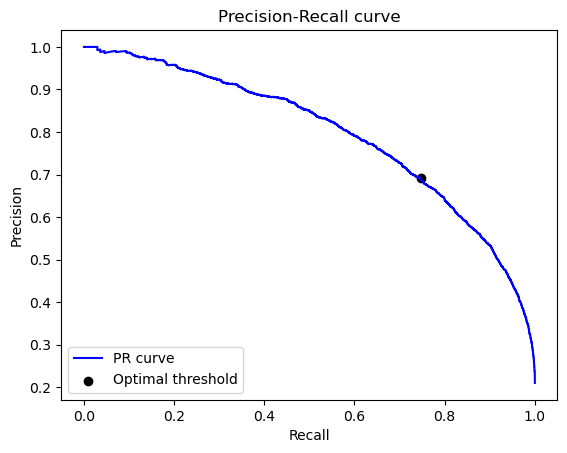

F1 Test:  0.7366803278688525
Recall Test:  0.7930980144973212
Precision Test:  0.6877562175457775


In [118]:
Voting_Classifier_Model(X_test, Y_test)

It was pleassure to take the course and work on this project. Thanks to all staff, especially our lecturer Prof. Felix Voigtlaender.